In [1]:
%pylab inline
%config InlineBackend.figure_formats = ['retina']

from collections import OrderedDict

import pandas as pd
import numpy as np
import seaborn as sns
sns.set()

import matplotlib.pyplot as plt

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score

import pickle

Populating the interactive namespace from numpy and matplotlib


In [2]:
# Pickle opening code
with open('sc_scaled.pickle','rb') as read_file:
    scs = pickle.load(read_file)

In [3]:
# Pickle opening code
with open('sc_noscale.pickle','rb') as read_file:
    scns = pickle.load(read_file)

### Variables
- **GameID**: Unique ID for each game
- **LeagueIndex**: 1-8 for Bronze, Silver, Gold, Platinum, Diamond, Master, GrandMaster, Professional leagues
- **Age**: Age of each player
- **HoursPerWeek**: Hours spent playing per week
- **TotalHours**: Total hours spent playing
- **APM**: Action per minute
- **SelectByHotkeys**: Number of unit selections made using hotkeys per timestamp
- **AssignToHotkeys**: Number of units assigned to hotkeys per timestamp
- **UniqueHotkeys**: Number of unique hotkeys used per timestamp
- **MinimapAttacks**: Number of attack actions on minimal per timestamp
- **MinimapRightClicks**: Number of right-clicks on minimal per timestamp
- **NumberOfPACs**: Number of PACs per timestamp
- **GapBetweenPACs**: Mean duration between PACs (milliseconds)
- **ActionLatency**: Mean latency from the onset of PACs to their first action (milliseconds)
- **ActionsInPAC**: Mean number of actions within each PAC
- **TotalMapExplored**: Number of 24x24 game coordinate grids viewed by player per timestamp
- **WorkersMade**: Number of SCVs, drones, probes trained per timestamp
- **UniqueUnitsMade**: Unique units made per timestamp
- **ComplexUnitsMade**: Number of ghosts, investors, and high templars trained per timestamp
- **ComplexAbilityUsed**: Abilities requiring specific targeting instructions used per timestamp
- **MaxTimeStamp**: Time stamp of game's last recorded event

### Notes
- Currently there are 7 StarCraft 2 leagues, and the 8th is the "Pro" League. 
- Breakdowns of league composition as a percentage of the player base and other details are here:
    - https://liquipedia.net/starcraft2/Battle.net_Leagues

In [62]:
sc = pd.read_csv('starcraft.csv')

In [63]:
sc.head()

,GameID,LeagueIndex,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,...,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
0,52,5,27.0,10.0,3000.0,143.7180,0.003515,0.000220,0.000055,0.000110,...,0.004849,32.6677,40.8673,4.7508,0.000220,0.001397,0.000047,0.0,0.000000,127448
1,55,5,23.0,10.0,5000.0,129.2322,0.003304,0.000259,0.000069,0.000294,...,0.004307,32.9194,42.3454,4.8434,0.000381,0.001194,0.000087,0.0,0.000208,57812
2,56,4,30.0,10.0,200.0,69.9612,0.001101,0.000336,0.000042,0.000294,...,0.002926,44.6475,75.3548,4.0430,0.000231,0.000745,0.000063,0.0,0.000189,95360
3,57,3,19.0,20.0,400.0,107.6016,0.001034,0.000213,0.000011,0.000053,...,0.003783,29.2203,53.7352,4.9155,0.000202,0.000426,0.000075,0.0,0.000384,93852
4,58,3,32.0,10.0,500.0,122.8908,0.001136,0.000327,0.000039,0.000000,...,0.002368,22.6885,62.0813,9.3740,0.000289,0.001174,0.000077,0.0,0.000019,51936


In [64]:
# Get info
sc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3395 entries, 0 to 3394
Data columns (total 21 columns):
GameID                3395 non-null int64
LeagueIndex           3395 non-null int64
Age                   3340 non-null float64
HoursPerWeek          3339 non-null float64
TotalHours            3338 non-null float64
APM                   3395 non-null float64
SelectByHotkeys       3395 non-null float64
AssignToHotkeys       3395 non-null float64
UniqueHotkeys         3395 non-null float64
MinimapAttacks        3395 non-null float64
MinimapRightClicks    3395 non-null float64
NumberOfPACs          3395 non-null float64
GapBetweenPACs        3395 non-null float64
ActionLatency         3395 non-null float64
ActionsInPAC          3395 non-null float64
TotalMapExplored      3395 non-null float64
WorkersMade           3395 non-null float64
UniqueUnitsMade       3395 non-null float64
ComplexUnitsMade      3395 non-null float64
ComplexAbilityUsed    3395 non-null float64
MaxTimeStamp     

## Remove Duplicate Players
- According to the supplementary info the researchers  discovered that a few individuals might have been able to submit multiple games to the study. In order to ensure independence of  observations, their consequent work drops the following games:
[1172,2183,2652,4064,4075,5247,7011,7988,8236,8750]

In [65]:
# Drop rows containing those GameIDs
scc = sc.loc[~sc['GameID'].isin([1172,2183,2652,4064,4075,5247,7011,7988,8236,8750])]

In [66]:
scc.loc[sc['GameID'].isin([1172,2183,2652,4064,4075,5247,7011,7988,8236,8750])]

,GameID,LeagueIndex,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,...,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp


- Yay, all gone.

### Remove GameID

In [67]:
# We don't need the GameID column any longer, so let's drop that too.
scc = scc.drop(['GameID'], axis=1)

## Remove crazy total hour values

- There are some crazy outlier values for total hours played.

In [68]:
scc.describe()

,LeagueIndex,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,MinimapRightClicks,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
count,3385.000000,3330.000000,3329.000000,3328.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000,3385.000000
mean,4.180798,21.648348,15.897266,960.122596,116.966144,0.004294,0.000373,0.000059,0.000098,0.000388,0.003462,40.392912,63.761769,5.270470,0.000282,0.001032,0.000085,0.000059,0.000142,83532.935894
std,1.517369,4.210560,11.970126,17344.126882,51.954923,0.005288,0.000224,0.000038,0.000165,0.000377,0.000993,17.165144,19.255581,1.494656,0.000086,0.000519,0.000025,0.000111,0.000265,33466.683854
min,1.000000,16.000000,0.000000,3.000000,22.059600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000679,6.666700,24.093600,2.038900,0.000091,0.000077,0.000020,0.000000,0.000000,25224.000000
25%,3.000000,19.000000,8.000000,300.000000,79.695600,0.001257,0.000204,0.000033,0.000000,0.000140,0.002751,28.969700,50.454200,4.271500,0.000224,0.000683,0.000068,0.000000,0.000000,60028.000000
50%,4.000000,21.000000,12.000000,500.000000,108.002400,0.002496,0.000353,0.000053,0.000040,0.000282,0.003395,36.804600,60.938900,5.093500,0.000270,0.000906,0.000082,0.000000,0.000020,80932.000000
75%,5.000000,24.000000,20.000000,800.000000,142.651800,0.005112,0.000499,0.000079,0.000118,0.000514,0.004026,48.299100,73.722400,6.029800,0.000325,0.001259,0.000099,0.000085,0.000181,101984.000000
max,8.000000,44.000000,168.000000,1000000.000000,389.831400,0.043088,0.001752,0.000338,0.003019,0.004041,0.007971,237.142900,176.372100,18.558100,0.000832,0.005149,0.000202,0.000902,0.003084,388032.000000


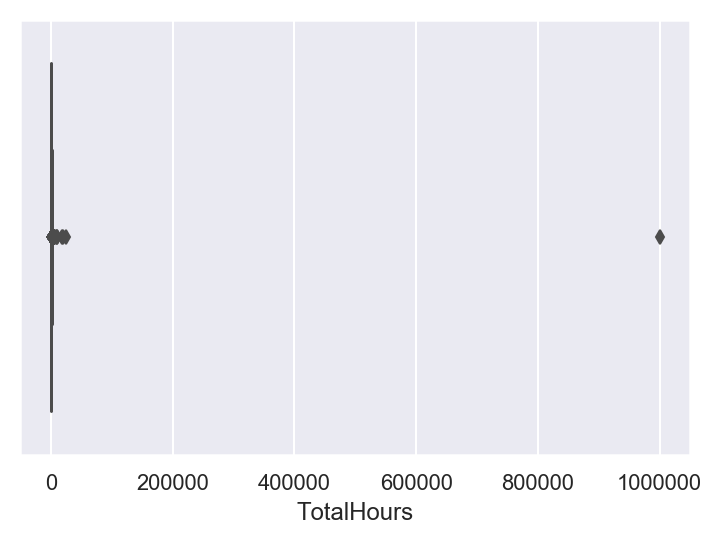

In [69]:
# Let's look at a boxplot of the values
sns.boxplot(scc['TotalHours'])

- Let's hone in on the outlier values by looking at values that are the traditional definition of outlier: 1.5 IQRs below the 1st Quartile or above the 3rd Quartile. 

In [70]:
TH_IQR = scc.describe().loc['75%', 'TotalHours'] - scc.describe().loc['25%', 'TotalHours']
TH_Outlier = TH_IQR + 800.0
TH_Outlier

1300.0

In [71]:
scc.loc[sc['TotalHours'] > TH_Outlier].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 264 entries, 0 to 3336
Data columns (total 20 columns):
LeagueIndex           264 non-null int64
Age                   264 non-null float64
HoursPerWeek          264 non-null float64
TotalHours            264 non-null float64
APM                   264 non-null float64
SelectByHotkeys       264 non-null float64
AssignToHotkeys       264 non-null float64
UniqueHotkeys         264 non-null float64
MinimapAttacks        264 non-null float64
MinimapRightClicks    264 non-null float64
NumberOfPACs          264 non-null float64
GapBetweenPACs        264 non-null float64
ActionLatency         264 non-null float64
ActionsInPAC          264 non-null float64
TotalMapExplored      264 non-null float64
WorkersMade           264 non-null float64
UniqueUnitsMade       264 non-null float64
ComplexUnitsMade      264 non-null float64
ComplexAbilityUsed    264 non-null float64
MaxTimeStamp          264 non-null int64
dtypes: float64(18), int64(2)
memory u

- This is a big portion of the dataset. Let's take care of the absurd outlier and see where that leaves us on a box plot.

In [72]:
scc.head()

,LeagueIndex,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,MinimapRightClicks,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
0,5,27.0,10.0,3000.0,143.7180,0.003515,0.000220,0.000055,0.000110,0.000392,0.004849,32.6677,40.8673,4.7508,0.000220,0.001397,0.000047,0.0,0.000000,127448
1,5,23.0,10.0,5000.0,129.2322,0.003304,0.000259,0.000069,0.000294,0.000432,0.004307,32.9194,42.3454,4.8434,0.000381,0.001194,0.000087,0.0,0.000208,57812
2,4,30.0,10.0,200.0,69.9612,0.001101,0.000336,0.000042,0.000294,0.000461,0.002926,44.6475,75.3548,4.0430,0.000231,0.000745,0.000063,0.0,0.000189,95360
3,3,19.0,20.0,400.0,107.6016,0.001034,0.000213,0.000011,0.000053,0.000543,0.003783,29.2203,53.7352,4.9155,0.000202,0.000426,0.000075,0.0,0.000384,93852
4,3,32.0,10.0,500.0,122.8908,0.001136,0.000327,0.000039,0.000000,0.001329,0.002368,22.6885,62.0813,9.3740,0.000289,0.001174,0.000077,0.0,0.000019,51936


In [73]:
# Drop egregious outlier
scc.drop(scc.loc[scc.loc[:, 'TotalHours'] == 1000000.0].index, inplace=True)

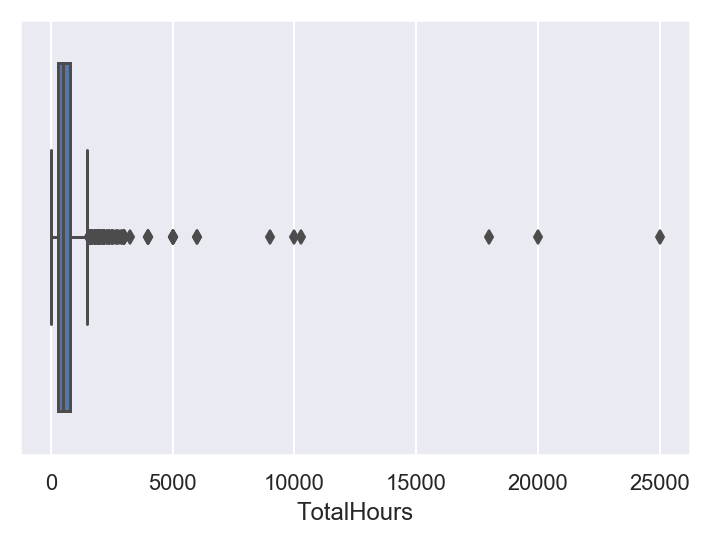

In [74]:
sns.boxplot(scc['TotalHours'])

In [75]:
# Closing in... Let's look at how many are over the outlier range x2


outliers = scc.loc[sc['TotalHours'] > TH_Outlier] # Normal outlier

outliers2IQR = scc.loc[sc['TotalHours'] > TH_Outlier * 2] # 2x IQR outlier

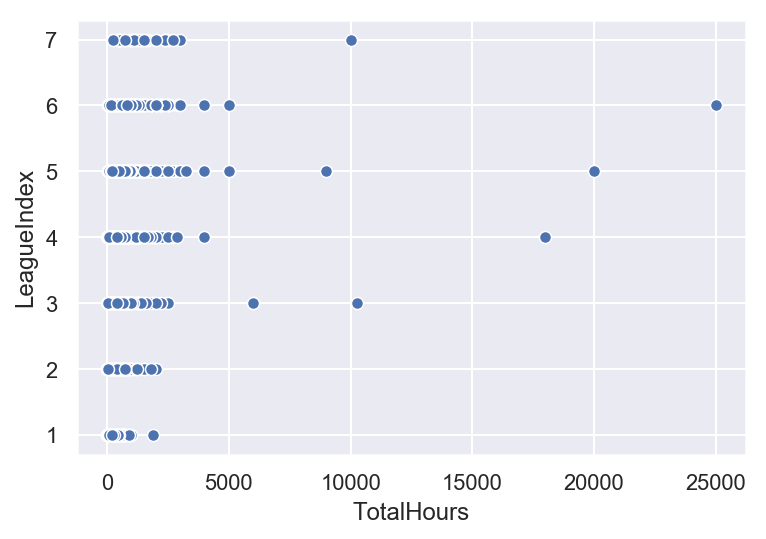

In [76]:
# Let's look at the league distribution of these outliers in a scatterplot.
sns.scatterplot(x = 'TotalHours', y = 'LeagueIndex', data=scc)

- There appears to be some correlation between more hours and higher ranking.
- The more skewed outliers seem to appear around 5000 hours, so let's see what that cutoff looks like. 

In [77]:
scc.loc[sc['TotalHours'] >= 5000].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12 entries, 1 to 3253
Data columns (total 20 columns):
LeagueIndex           12 non-null int64
Age                   12 non-null float64
HoursPerWeek          12 non-null float64
TotalHours            12 non-null float64
APM                   12 non-null float64
SelectByHotkeys       12 non-null float64
AssignToHotkeys       12 non-null float64
UniqueHotkeys         12 non-null float64
MinimapAttacks        12 non-null float64
MinimapRightClicks    12 non-null float64
NumberOfPACs          12 non-null float64
GapBetweenPACs        12 non-null float64
ActionLatency         12 non-null float64
ActionsInPAC          12 non-null float64
TotalMapExplored      12 non-null float64
WorkersMade           12 non-null float64
UniqueUnitsMade       12 non-null float64
ComplexUnitsMade      12 non-null float64
ComplexAbilityUsed    12 non-null float64
MaxTimeStamp          12 non-null int64
dtypes: float64(18), int64(2)
memory usage: 2.0 KB


In [78]:
scc.loc[sc['TotalHours'] >= TH_Outlier * 2].LeagueIndex.value_counts().sort_index()

3     3
4     5
5    14
6     7
7     3
Name: LeagueIndex, dtype: int64

/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


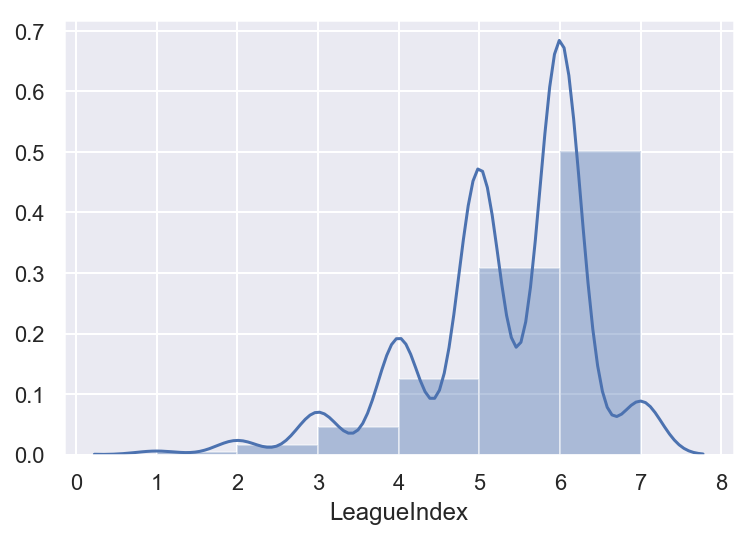

In [79]:
sns.distplot(outliers.LeagueIndex, bins=6)

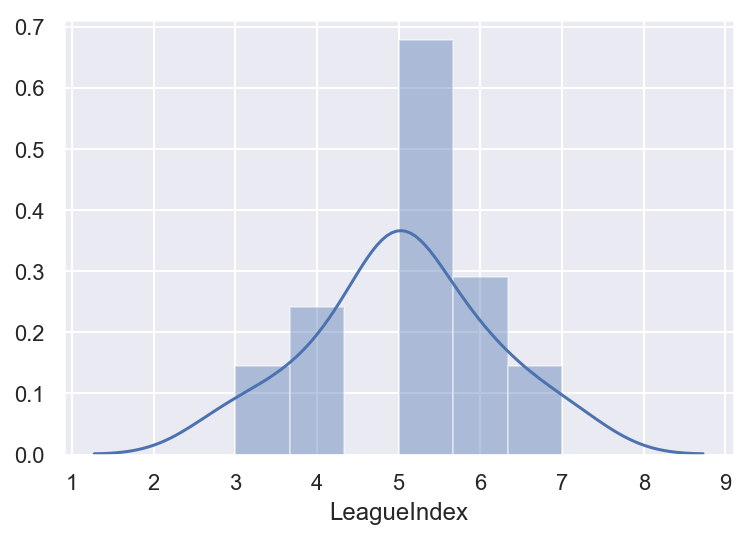

In [80]:
sns.distplot(outliers2IQR.LeagueIndex, bins=6)

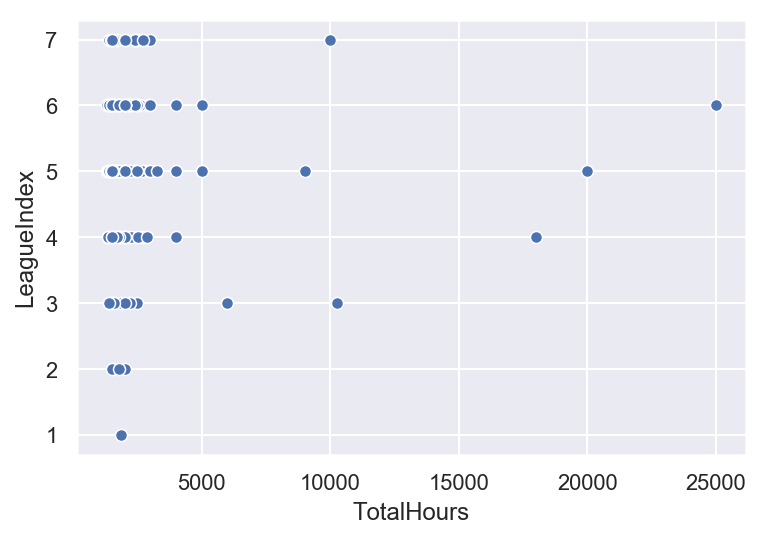

In [81]:
sns.scatterplot(x='TotalHours',
                y='LeagueIndex',
                data=outliers)

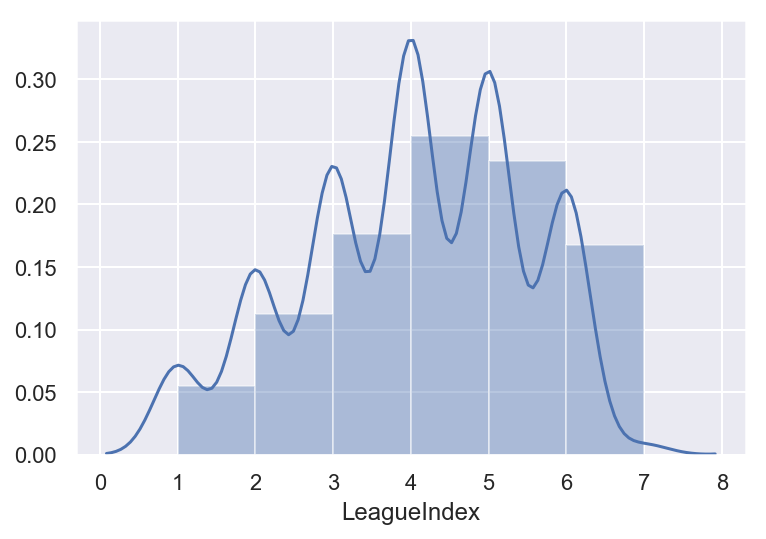

In [82]:
sns.distplot(scc.LeagueIndex.loc[scc['TotalHours'] < TH_Outlier], bins=6)

- Normal outliers definitely center around a higher LeagueIndex
- Center of the distributions of the outliers and the rest are about the same, but the spread is different. However, it doesn't seem different enough to warrant keeping them. 
- Removing the 31 outliers for 2xIQR.

In [83]:
# Dropping 31 outlier rows
scc = scc.drop(scc[scc.TotalHours >= TH_Outlier * 2].index)

## Handling NaNs

- Several nulls as we can see the difference between Age, HoursPerWeek, and TotalHours vs the other attributes. 

In [84]:
# Sum up the number of NaNs
scc.isna().sum()

LeagueIndex            0
Age                   55
HoursPerWeek          56
TotalHours            57
APM                    0
SelectByHotkeys        0
AssignToHotkeys        0
UniqueHotkeys          0
MinimapAttacks         0
MinimapRightClicks     0
NumberOfPACs           0
GapBetweenPACs         0
ActionLatency          0
ActionsInPAC           0
TotalMapExplored       0
WorkersMade            0
UniqueUnitsMade        0
ComplexUnitsMade       0
ComplexAbilityUsed     0
MaxTimeStamp           0
dtype: int64

- Ok similar numbers of NaNs for the three attributes. Let's look at these three attributes in detail.
- Create a df of only the null rows and one without the null rows. 

In [85]:
# Create df made up of only those rows that have nulls and compare to full df
scc_null = scc[scc.isnull().any(axis=1)]

In [86]:
# Create df without the null values
scc_nonull = scc[~scc.isnull().any(axis=1)]

- Let's look at the distribution of LeagueIndex vs Age.

### Player Age NaNs

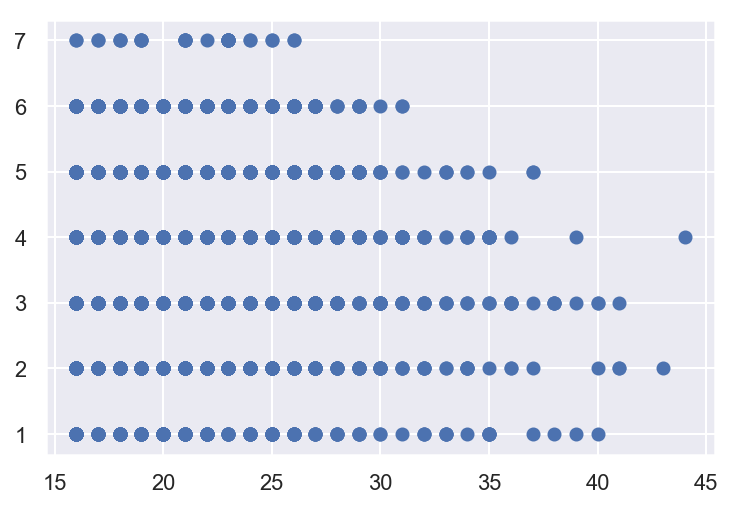

In [87]:
# Plot league ranking vs Age
plt.scatter(scc_nonull.Age, scc_nonull.LeagueIndex)

- There does seem to be a relationship between age and league ranking.
- Let's look at the mean and median age per LeagueIndex.

In [88]:
# Mean age per LeagueIndex
scc_nonull.groupby(['LeagueIndex']).Age.mean()

LeagueIndex
1    22.724551
2    22.155620
3    22.071038
4    21.983851
5    21.371029
6    20.682566
7    21.250000
Name: Age, dtype: float64

In [89]:
# Median age per LeagueIndex
scc_nonull.groupby(['LeagueIndex']).Age.median()

LeagueIndex
1    21.0
2    21.0
3    21.0
4    21.0
5    21.0
6    20.0
7    21.5
Name: Age, dtype: float64

- Mean and median are extremely close.
- Let's look at box and violin plots to see this visually.

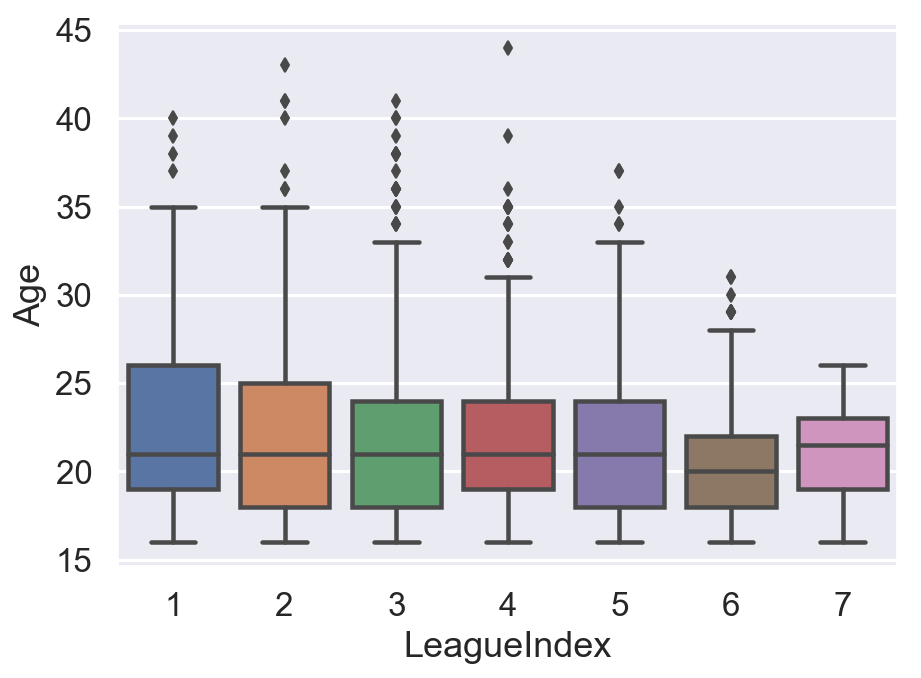

In [99]:
# Boxplot
fig, ax = pyplot.subplots(figsize=(7,5))
sns.boxplot(ax=ax, x="LeagueIndex", y="Age", data=scc_nonull)

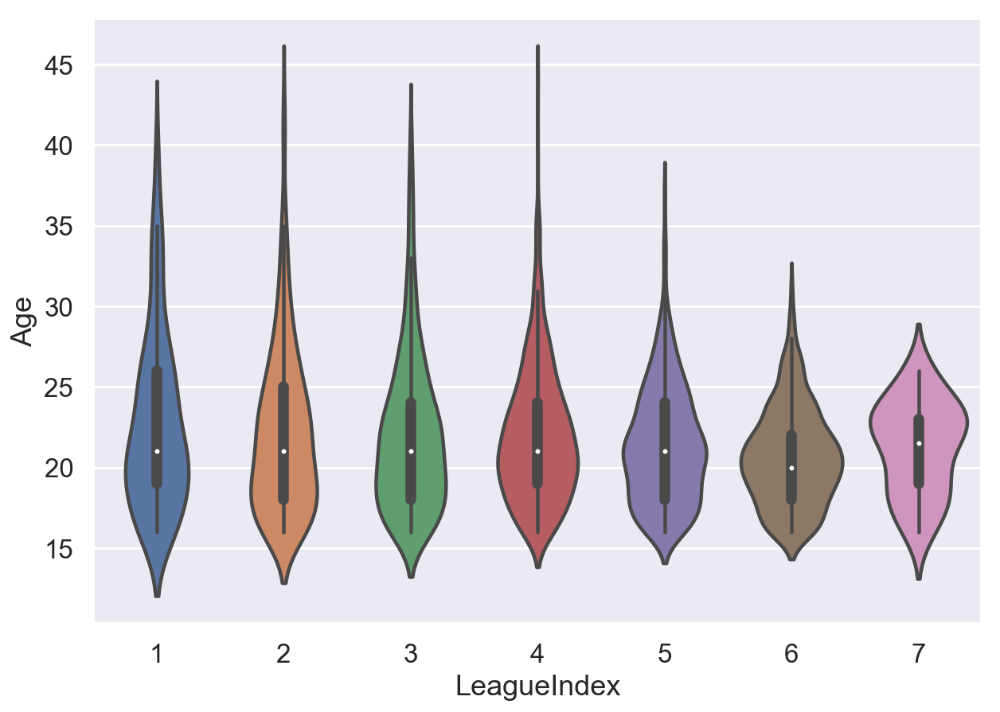

In [103]:
# Boxplot
fig, ax = pyplot.subplots(figsize=(10,7))
sns.violinplot(ax=ax, x="LeagueIndex", y="Age", data=scc_nonull)

- The mean and medians for age are pretty close across the board, so it's probably safe to take either the mean of the means or the mean of LeagueIndex.
- For some outside reference here are a couple of useful links for player age:
    - Players' age in GSL: https://www.reddit.com/r/starcraft/comments/9erxwm/players_age_in_gsl/
    - https://imgur.com/a/FhHayNP
    - Note the age at the time of the survey in 2013. This is consistent with what we see in the data. 
    - Over time it seems these ages have gone, up as you might expect with an older game.
- However, if they are just the same across the board __age probably doesn't matter much__ and we can __just eliminate it as a feature__.
    - Let's try to confirm if this is the case. 

- As an extra step, let's dig a tad deeper and __see if there are any correlations between age and the other attributes.__ 

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in log
  


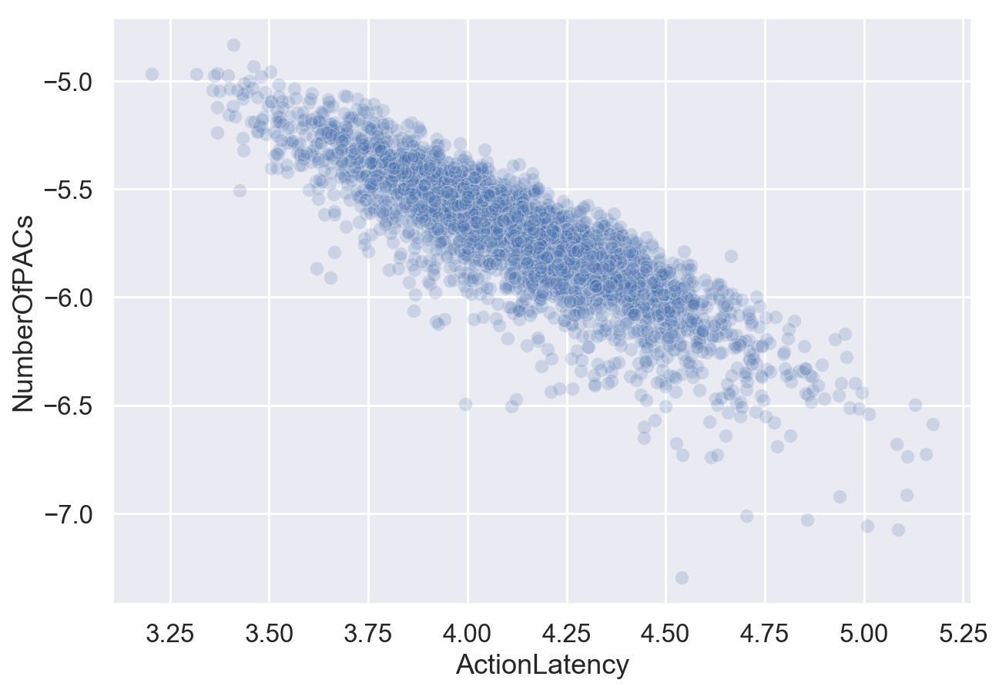

In [105]:
fig, ax = pyplot.subplots(figsize=(10,7))
sns.scatterplot(x='ActionLatency', y='NumberOfPACs', data=np.log(scc_nonull), alpha=0.2)

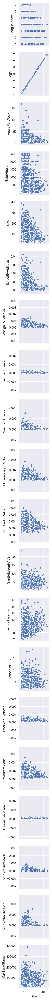

In [36]:
sns.pairplot(scc_nonull,
             x_vars=['Age'],
             y_vars=scc.columns)

- The differing scales of the values is making this plot difficult to interpret. Let's separate the features out, scale and rerun the pairplot. 

In [37]:
# Create separate data and target dataframes based on the nonull versions.
scc_nonull_X = scc_nonull.drop('LeagueIndex', axis=1)
scc_nonull_y = scc_nonull['LeagueIndex']

In [38]:
scc_nonull_X.head()

,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,MinimapRightClicks,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
2,30.0,10.0,200.0,69.9612,0.001101,0.000336,0.000042,0.000294,0.000461,0.002926,44.6475,75.3548,4.0430,0.000231,0.000745,0.000063,0.0,0.000189,95360
3,19.0,20.0,400.0,107.6016,0.001034,0.000213,0.000011,0.000053,0.000543,0.003783,29.2203,53.7352,4.9155,0.000202,0.000426,0.000075,0.0,0.000384,93852
4,32.0,10.0,500.0,122.8908,0.001136,0.000327,0.000039,0.000000,0.001329,0.002368,22.6885,62.0813,9.3740,0.000289,0.001174,0.000077,0.0,0.000019,51936
5,27.0,6.0,70.0,44.4570,0.000978,0.000255,0.000021,0.000000,0.000000,0.002425,76.4405,98.7719,3.0965,0.000170,0.000372,0.000064,0.0,0.000000,94032
6,21.0,8.0,240.0,46.9962,0.000820,0.000169,0.000067,0.000000,0.000045,0.001988,94.0227,90.5311,4.1017,0.000169,0.000573,0.000056,0.0,0.000000,89012


### Use scale function of scikit-learn to normalize data

- Our data has zeroes in it so we can't take the log. 
- There are several options for normalizing, but we will use scikit-learn's scale() preprocessor. 

In [39]:
# Use the Scikit-learn scale function to normalize. 
from sklearn import preprocessing

scc_nonull_X_scaled = pd.DataFrame(preprocessing.scale(scc_nonull_X), columns=scc_nonull_X.columns)
scc_nonull_X_scaled

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  after removing the cwd from sys.path.


,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,MinimapRightClicks,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
0,1.978195,-0.487760,-0.913908,-0.923157,-0.618103,-0.130596,-0.424298,1.296159,0.226192,-0.518114,0.223467,0.576436,-0.811258,-0.592084,-0.548659,-0.876679,-0.536671,0.180058,0.349383
1,-0.631058,0.354131,-0.467736,-0.134948,-0.632591,-0.717046,-1.251757,-0.247813,0.453768,0.371046,-0.678781,-0.558353,-0.231370,-0.920504,-1.159839,-0.403799,-0.536671,0.917033,0.304530
2,2.452604,-0.487760,-0.244650,0.185216,-0.610612,-0.170073,-0.514470,-0.590241,2.632802,-1.096627,-1.060789,-0.120275,2.731871,0.083281,0.276776,-0.306798,-0.536671,-0.460984,-0.942175
3,1.266580,-0.824516,-1.203920,-1.457228,-0.644420,-0.515299,-0.970633,-0.590241,-1.054362,-1.038089,2.082857,1.805575,-1.440328,-1.295783,-1.263491,-0.840304,-0.536671,-0.533993,0.309884
4,-0.156649,-0.656138,-0.824674,-1.404055,-0.678368,-0.930539,0.251991,-0.590241,-0.929750,-1.490776,3.111139,1.373024,-0.772244,-1.314820,-0.878084,-1.147474,-0.536671,-0.533993,0.160574
5,-0.868263,0.690887,0.424608,0.878238,0.229722,0.772233,1.111275,-0.429627,0.053879,0.149359,-0.956997,-0.641359,0.865863,0.642406,0.537490,-0.391674,-0.536671,-0.533993,-0.103424
6,1.029375,-0.992894,-0.936217,-0.727706,-0.773080,-0.515921,-0.880461,-0.484236,-0.597595,0.134868,-0.069504,0.059169,-0.689033,-1.456187,-0.524603,-1.090890,0.424928,0.462145,1.127458
7,-0.868263,-0.319382,-0.579279,-0.975211,-0.763646,-0.928183,-1.214627,-0.435409,-0.652316,-0.560181,0.094188,0.193026,-0.625694,-1.028505,-0.541133,-0.003669,-0.536671,1.109996,-0.023118
8,3.875833,-0.824516,0.870780,0.112883,0.207873,-1.488008,-0.612598,-0.031948,-0.957781,-0.723372,0.821428,0.778802,0.641817,0.967351,0.890740,0.093332,-0.536671,-0.533993,-0.775139
9,-1.105468,0.017374,1.986211,-0.675828,-0.353771,0.323737,0.867281,-0.590241,-0.362734,-0.544983,0.253756,0.019802,-0.486787,0.676121,0.414044,2.075025,-0.536671,0.323012,-1.174051


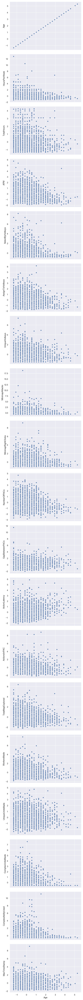

In [40]:
# Now let's try that pairplot again
sns.pairplot(scc_nonull_X_scaled,
             x_vars=['Age'],
             y_vars=scc_nonull_X_scaled.columns,
             height=4,
             aspect=1.6)

- There really doesn't seem to be a very strong relationship between age and any other value.
- Let's look at HoursPerWeek and TotalHours.

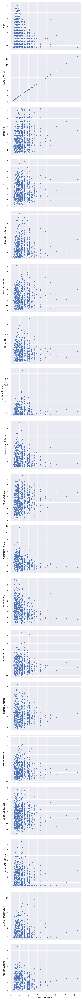

In [41]:
# HoursPerWeek correlations
sns.pairplot(scc_nonull_X_scaled,
             x_vars=['HoursPerWeek'],
             y_vars=scc_nonull_X_scaled.columns,
             height=4,
             aspect=1.6)

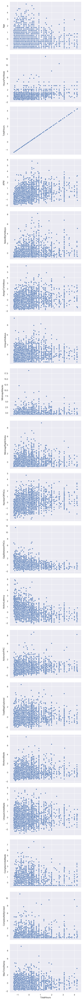

In [42]:
# TotalHours correlations
sns.pairplot(scc_nonull_X_scaled,
             x_vars=['TotalHours'],
             y_vars=scc_nonull_X_scaled.columns,
             height=4,
             aspect=1.6)

In [43]:
# And let's look at everything again, with the scaled 
# Use reset index to handle possible index label conflicts
scc_nonull_scaled = pd.concat([scc_nonull_y.reset_index(drop=True), scc_nonull_X_scaled.reset_index(drop=True)], axis=1)

## Dataframe with scaled numerical values and integer LeagueIndex values

In [44]:
scc_nonull_scaled.Age.isna().value_counts()

False    3295
Name: Age, dtype: int64

In [45]:
# Another look at the pairplot with scaled values and no nulls
sns.pairplot(scc_nonull_scaled,
             height=3,
             aspect=1.6)

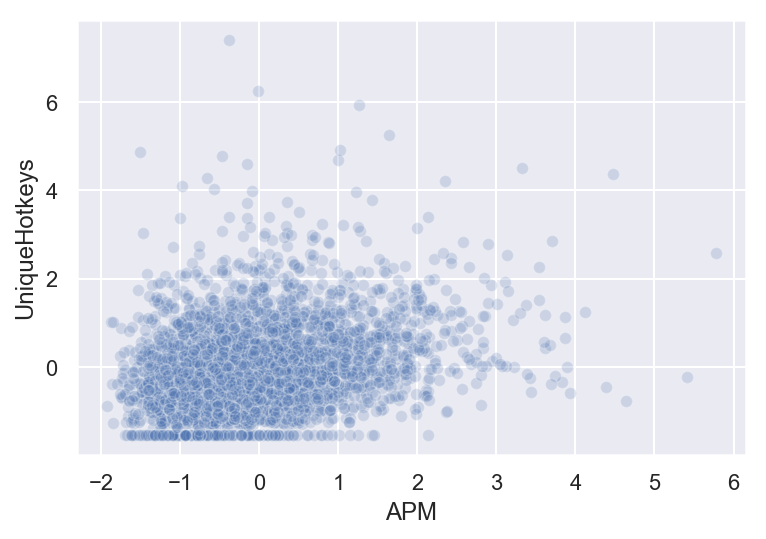

In [47]:
sns.scatterplot(x='APM', y='UniqueHotkeys', data=scc_nonull_scaled, alpha=0.2)

## NaN Conclusion
- Ok, because I want to keep the top tier players in the mix I'm going to... 
    - Set their ages to the mean age.
    - Set their HoursPerWeek to 9 hours per day and set their total hours to the ratio of TotalHours/HoursPerWeek for LeagueIndex 7 players times their HoursPerWeek. 
    - This was kind of an arbitrary estimate.

#### Fill NaN values before scaling

In [48]:
# Reset Index
scc_fn = scc.reset_index(drop=True)

In [49]:
# Change Age NaNs to mean age
scc_fn.Age.fillna(scc_fn.Age.mean(), inplace=True)

In [50]:
# Change HoursPerWeek to 63 hours per week
scc_fn.HoursPerWeek.fillna(63, inplace=True)

In [51]:
# Find the average amount of weeks played by L7 players and multiply by 70
L7_TotalHours = scc_fn.loc[scc_fn['LeagueIndex'] == 7].TotalHours.mean()
L7_HoursPerWeek = scc_fn.loc[scc_fn['LeagueIndex'] == 7].HoursPerWeek.mean()
L7_HoursRatio = L7_TotalHours / L7_HoursPerWeek
ProTotalHours = L7_HoursRatio * 63

In [52]:
# Change TotalHours to ProTotalHours
scc_fn.TotalHours.fillna(ProTotalHours, inplace=True)

In [53]:
# Separate target and data so data can be scaled
scc_X = scc_fn.drop('LeagueIndex', axis=1)
scc_y = scc_fn['LeagueIndex']

In [54]:
# Scale data
scc_X_scaled = pd.DataFrame(preprocessing.scale(scc_X), columns=scc_X.columns)

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by the scale function.
  


#### Create df with scaled data and non-scaled target combined

In [55]:
# Concat dfs into SCN
scn = pd.concat([scc_y.reset_index(drop=True), scc_X_scaled.reset_index(drop=True)], axis=1)

## Cleaned, Scaled Dataframe Created
- df is called scn ^^
- Duplicate players removed
- NaN values filled in order to keep pro players and NaN value columns. All pro level players had no Age, HoursPerWeek, or TotalHour values. 
    - Age: Changed to mean age
    - HoursPerWeek: Changed to 63, assuming 9 hours every day. Conservative estimate for a pro.
    - TotalHours: Changed to the proo HoursPerWeek above, times the average weeks played by LeagueIndex 7 players. Again, probably a conservative estimate, but it did skew the data slightly to the right, as you might expect. 

In [56]:
scn.head()

,LeagueIndex,Age,HoursPerWeek,TotalHours,APM,SelectByHotkeys,AssignToHotkeys,UniqueHotkeys,MinimapAttacks,MinimapRightClicks,NumberOfPACs,GapBetweenPACs,ActionLatency,ActionsInPAC,TotalMapExplored,WorkersMade,UniqueUnitsMade,ComplexUnitsMade,ComplexAbilityUsed,MaxTimeStamp
0,4,1.995238,-0.497243,-0.868298,-0.901446,-0.603674,-0.164425,-0.437505,1.210325,0.196328,-0.534002,0.243039,0.595096,-0.818557,-0.598793,-0.551460,-0.879880,-0.533719,0.180487,0.354946
1,3,-0.635699,0.258040,-0.475804,-0.173265,-0.616573,-0.710979,-1.248069,-0.265169,0.413261,0.330582,-0.654020,-0.527467,-0.236393,-0.926409,-1.164267,-0.405675,-0.533719,0.918536,0.309943
2,3,2.473590,-0.497243,-0.279557,0.122516,-0.597005,-0.201217,-0.525835,-0.592410,2.490394,-1.096526,-1.033831,-0.094109,2.738477,0.074920,0.276170,-0.308402,-0.533719,-0.461489,-0.940952
3,2,1.277709,-0.799357,-1.123419,-1.394844,-0.627104,-0.522957,-0.972685,-0.592410,-1.024341,-1.039606,2.091735,1.810992,-1.450095,-1.300770,-1.268195,-0.843403,-0.533719,-0.534605,0.315315
4,1,-0.157347,-0.648300,-0.789799,-1.345721,-0.657328,-0.909948,0.224976,-0.592410,-0.905557,-1.479782,3.114103,1.383102,-0.779390,-1.319759,-0.881762,-1.151433,-0.533719,-0.534605,0.165503


In [57]:
# Breakdown of leagues
scn['LeagueIndex'].value_counts().sort_index()

1    167
2    347
3    549
4    805
5    789
6    608
7     32
8     55
Name: LeagueIndex, dtype: int64

- Ok so there are no age or hours played measurements for Pro Leagues. How to deal with these...?

In [58]:
scn.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3352 entries, 0 to 3351
Data columns (total 20 columns):
LeagueIndex           3352 non-null int64
Age                   3352 non-null float64
HoursPerWeek          3352 non-null float64
TotalHours            3352 non-null float64
APM                   3352 non-null float64
SelectByHotkeys       3352 non-null float64
AssignToHotkeys       3352 non-null float64
UniqueHotkeys         3352 non-null float64
MinimapAttacks        3352 non-null float64
MinimapRightClicks    3352 non-null float64
NumberOfPACs          3352 non-null float64
GapBetweenPACs        3352 non-null float64
ActionLatency         3352 non-null float64
ActionsInPAC          3352 non-null float64
TotalMapExplored      3352 non-null float64
WorkersMade           3352 non-null float64
UniqueUnitsMade       3352 non-null float64
ComplexUnitsMade      3352 non-null float64
ComplexAbilityUsed    3352 non-null float64
MaxTimeStamp          3352 non-null float64
dtypes: float64

## Pickle Cleaned DataFrames

In [ ]:
# # Pickle scaled data frame
# import pickle

# with open('sc_scaled.pickle', 'wb') as to_write:
#     pickle.dump(scn, to_write)

In [ ]:
# # Pickle unscaled data frame
# import pickle

# with open('sc_noscale.pickle', 'wb') as to_write:
#     pickle.dump(scc_fn, to_write)

---